In [1]:
import os
import numpy as np
import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
from torchvision import models
from PIL import Image
import matplotlib.pyplot as plt
import random
import torch.optim as optim
import torchvision.transforms as transforms

In [2]:
MEAN = np.array([0.485, 0.456, 0.406])
STD = np.array([0.229, 0.224, 0.225])
CLASS_NAMES = [ "arctic fox", "corgi", "electric ray", "goldfish", "hammerhead shark", "horse", "hummingbird", "indigo finch",  "puma", "red panda"]
DATA_ROOT = "networkvisualization"  
MODEL_WEIGHTS_PATH = "network_visualization.pth" 
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
DEVICE = "mps" if DEVICE == "cpu" else DEVICE

In [3]:
def get_model(num_classes=10, weights_path=MODEL_WEIGHTS_PATH):
    model = models.resnet18(pretrained=False)   
    model.fc = nn.Linear(512, num_classes)
    state_dict = torch.load(weights_path, map_location=DEVICE)
    model.load_state_dict(state_dict)
    return model.to(DEVICE)

def preprocess_image_pil(pil_img, resize=224):
    transform = transforms.Compose([ transforms.Resize(resize), transforms.CenterCrop(resize), transforms.ToTensor(), transforms.Normalize(mean=MEAN, std=STD) ])
    return transform(pil_img)

def load_subset_of_images(data_root, class_names, pick_index=0): 
    subset_data = []
    for class_idx, cls_name in enumerate(class_names):
        class_folder = os.path.join(data_root, cls_name)
        image_files = [ f for f in os.listdir(class_folder) if f.lower().endswith(('jpeg'))]
        image_files.sort()
        image_path = os.path.join(class_folder, image_files[pick_index])
        pil_img = Image.open(image_path).convert("RGB")
        img_tensor = preprocess_image_pil(pil_img).unsqueeze(0) 
        subset_data.append((img_tensor, class_idx, pil_img))
    return subset_data

def predict(model, images):
    model.eval()
    preds = []
    with torch.no_grad():
        for img_tensor in images:
            img_tensor = img_tensor.to(DEVICE)
            logits = model(img_tensor)
            pred_class = torch.argmax(logits, dim=1).item()
            preds.append(pred_class)
    return preds

/opt/anaconda3/envs/cv/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/anaconda3/envs/cv/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
/var/folders/vm/wmkh255j12x_ylgv2g4ltlhr0000gn/T/ipykernel_75169/2023307460.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value fo

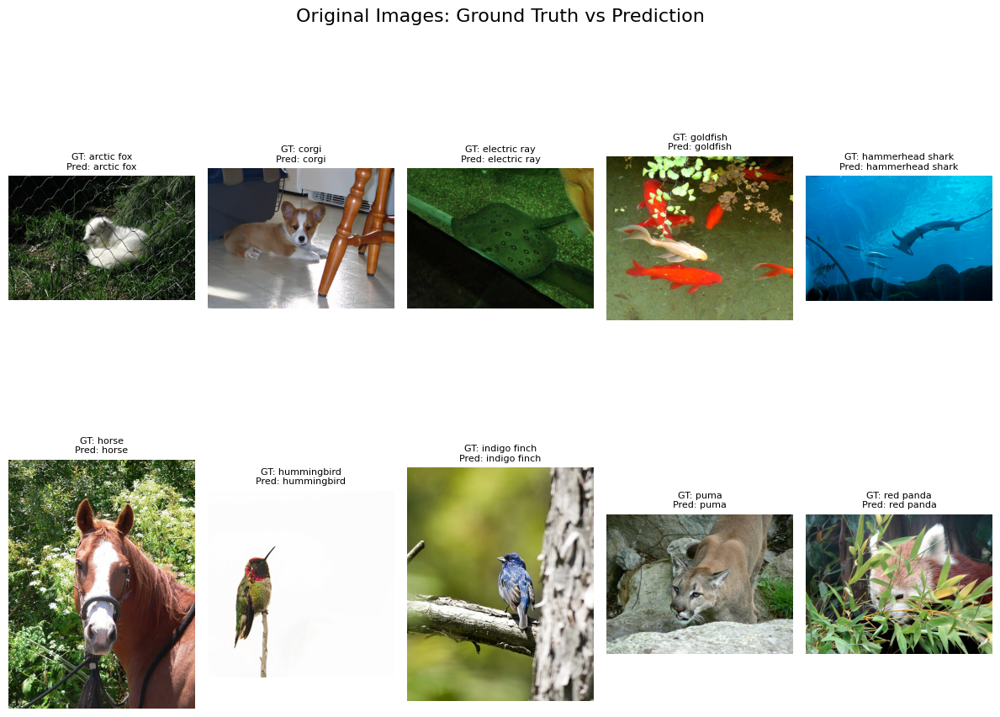

In [4]:
model = get_model(num_classes=10, weights_path=MODEL_WEIGHTS_PATH)
subset_data = load_subset_of_images(DATA_ROOT, CLASS_NAMES, pick_index=0)
images_for_pred = [item[0] for item in subset_data]
gts = [item[1] for item in subset_data]
pil_images = [item[2] for item in subset_data]
predictions = predict(model, images_for_pred)
plt.figure(figsize=(12, 10))
for i, (img_tensor, gt, pil_img) in enumerate(subset_data):
    plt.subplot(2, 5, i+1)
    plt.imshow(pil_img)
    title_str = f"GT: {CLASS_NAMES[gt]}\nPred: {CLASS_NAMES[predictions[i]]}"
    plt.title(title_str, fontsize=8)
    plt.axis('off')
plt.tight_layout()
plt.suptitle("Original Images: Ground Truth vs Prediction", fontsize=16)
plt.show()

In [5]:
def compute_saliency_map(model, image_tensor, class_idx):
    model.eval()
    image_tensor = image_tensor.clone().detach().to(DEVICE)
    image_tensor.requires_grad_(True) 
    logits = model(image_tensor)   
    score = logits[0, class_idx]   
    model.zero_grad()   
    if image_tensor.grad is not None:
        image_tensor.grad.zero_()   
    score.backward()   
    grad = image_tensor.grad.data   
    saliency = grad.abs().squeeze().max(dim=0)[0]   
    saliency_map = saliency.cpu().numpy()   
    return saliency_map

saliency_maps = []
for (img_tensor, gt, pil_img) in subset_data:
    sal_map = compute_saliency_map(model, img_tensor, gt)
    saliency_maps.append(sal_map)

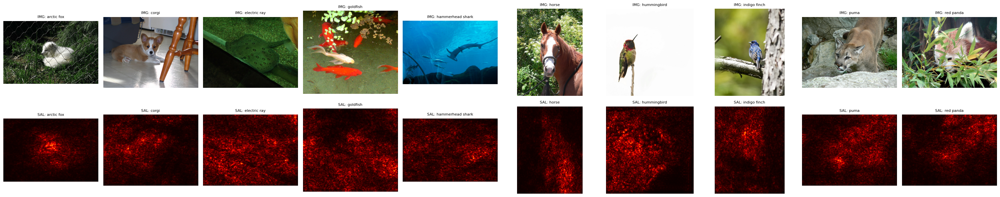

In [6]:
def resize_saliency_map(saliency_map, original_image):
    original_size = original_image.size  
    saliency_map_resized = np.array(Image.fromarray(saliency_map).resize(original_size, resample=Image.BILINEAR))
    return saliency_map_resized

saliency_maps_resized = []
for (img_tensor, gt, pil_img), sal_map in zip(subset_data, saliency_maps):
    resized_sal_map = resize_saliency_map(sal_map, pil_img)
    saliency_maps_resized.append(resized_sal_map)

fig, axes = plt.subplots(2, len(subset_data), figsize=(3 * len(subset_data), 6))
for i, ((img_tensor, gt, pil_img), sal_map) in enumerate(zip(subset_data, saliency_maps_resized)):
    axes[0, i].imshow(pil_img)
    axes[0, i].set_title(f"IMG: {CLASS_NAMES[gt]}", fontsize=8)
    axes[0, i].axis('off')
    axes[1, i].imshow(sal_map, cmap='hot')
    axes[1, i].set_title(f"SAL: {CLASS_NAMES[gt]}", fontsize=8)
    axes[1, i].axis('off')
plt.tight_layout()
plt.show()

In [7]:
def unnormalize_tensor(img_tensor):
    img = img_tensor.clone().detach().cpu()
    for c in range(3):
        img[0, c] = img[0, c] * STD[c] + MEAN[c]
    img = torch.clamp(img, 0, 1)
    img = img.squeeze(0).permute(1, 2, 0).numpy()
    return img

def tensor_to_resized_array(img_tensor, target_size): 
    arr = unnormalize_tensor(img_tensor)   
    pil_img = Image.fromarray((arr * 255).astype(np.uint8))
    pil_resized = pil_img.resize(target_size, Image.BILINEAR)
    arr_resized = np.array(pil_resized).astype(np.float32) / 255.0
    return arr_resized

def apply_mask_to_image(image_tensor, saliency_map, threshold, mask_type, target_size): 
    img_array = tensor_to_resized_array(image_tensor, target_size)   
    resized_sal_map = np.array(Image.fromarray(saliency_map).resize(target_size, Image.BILINEAR))
    mask = (resized_sal_map < threshold).astype(np.float32)   
    mask = np.expand_dims(mask, axis=2)   
    if mask_type == "constant":
        masked_img = img_array * (1 - mask)   
    elif mask_type == "gaussian":
        noise = np.random.randn(*img_array.shape) * 0.5
        masked_img = img_array * (1 - mask) + noise * mask
        masked_img = np.clip(masked_img, 0, 1)
    return masked_img

def preprocess_image_from_array(np_img, resize=224):
    pil_img = Image.fromarray((np_img * 255).astype(np.uint8))
    transform = transforms.Compose([ transforms.Resize(resize), transforms.CenterCrop(resize), transforms.ToTensor(), transforms.Normalize(mean=MEAN, std=STD) ])
    tensor = transform(pil_img).unsqueeze(0)
    return tensor

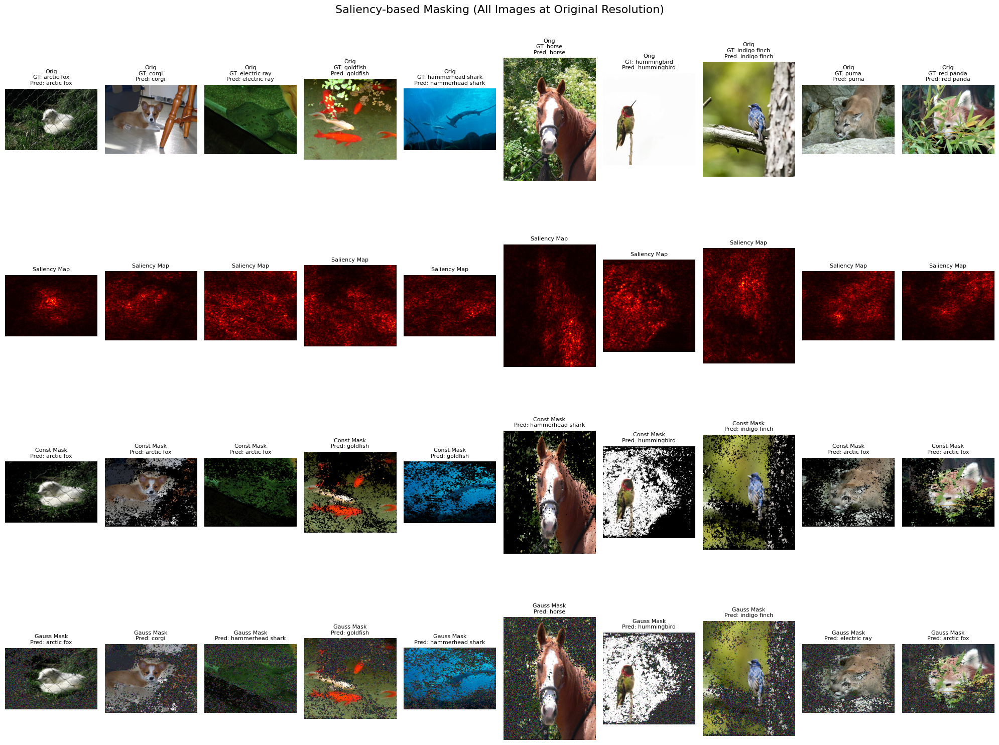

Summary of Predictions:
Image 1: GT: arctic fox, Orig: arctic fox, Const Mask: arctic fox, Gauss Mask: arctic fox
Image 2: GT: corgi, Orig: corgi, Const Mask: arctic fox, Gauss Mask: corgi
Image 3: GT: electric ray, Orig: electric ray, Const Mask: arctic fox, Gauss Mask: hammerhead shark
Image 4: GT: goldfish, Orig: goldfish, Const Mask: goldfish, Gauss Mask: goldfish
Image 5: GT: hammerhead shark, Orig: hammerhead shark, Const Mask: goldfish, Gauss Mask: hammerhead shark
Image 6: GT: horse, Orig: horse, Const Mask: hammerhead shark, Gauss Mask: horse
Image 7: GT: hummingbird, Orig: hummingbird, Const Mask: hummingbird, Gauss Mask: hummingbird
Image 8: GT: indigo finch, Orig: indigo finch, Const Mask: indigo finch, Gauss Mask: indigo finch
Image 9: GT: puma, Orig: puma, Const Mask: arctic fox, Gauss Mask: electric ray
Image 10: GT: red panda, Orig: red panda, Const Mask: arctic fox, Gauss Mask: arctic fox


In [8]:
modified_images_constant = []
modified_images_gaussian = []
resized_saliency_maps = []
thresholds = []
predictions_const = []
predictions_gauss = []
original_predictions = []

for (img_tensor, gt, pil_img), sal_map in zip(subset_data, saliency_maps):
    target_size = pil_img.size   
    resized_sal_map = np.array(Image.fromarray(sal_map).resize(target_size, Image.BILINEAR))
    resized_saliency_maps.append(resized_sal_map)
    threshold = np.percentile(resized_sal_map, 50)
    thresholds.append(threshold)
    mod_img_const = apply_mask_to_image(img_tensor, sal_map, threshold, "constant", target_size)
    mod_img_gauss = apply_mask_to_image(img_tensor, sal_map, threshold, "gaussian", target_size)
    modified_images_constant.append(mod_img_const)
    modified_images_gaussian.append(mod_img_gauss)

for (img_tensor, gt, pil_img), mod_const, mod_gauss in zip(subset_data, modified_images_constant, modified_images_gaussian):
    pred_orig = predict(model, [img_tensor])[0]
    original_predictions.append(pred_orig)
    tensor_const = preprocess_image_from_array(mod_const, resize=224)
    pred_const = predict(model, [tensor_const])[0]
    predictions_const.append(pred_const)
    tensor_gauss = preprocess_image_from_array(mod_gauss, resize=224)
    pred_gauss = predict(model, [tensor_gauss])[0]
    predictions_gauss.append(pred_gauss)

num_images = len(subset_data)
fig, axes = plt.subplots(4, num_images, figsize=(20, 16))

for i, ((img_tensor, gt, pil_img), sal_map_disp) in enumerate(zip(subset_data, resized_saliency_maps)):
    axes[0, i].imshow(pil_img)
    axes[0, i].set_title(f"Orig\nGT: {CLASS_NAMES[gt]}\nPred: {CLASS_NAMES[original_predictions[i]]}", fontsize=8)
    axes[0, i].axis('off')
    axes[1, i].imshow(sal_map_disp, cmap='hot')
    axes[1, i].set_title("Saliency Map", fontsize=8)
    axes[1, i].axis('off')
    axes[2, i].imshow(modified_images_constant[i])
    axes[2, i].set_title(f"Const Mask\nPred: {CLASS_NAMES[predictions_const[i]]}", fontsize=8)
    axes[2, i].axis('off')
    axes[3, i].imshow(modified_images_gaussian[i])
    axes[3, i].set_title(f"Gauss Mask\nPred: {CLASS_NAMES[predictions_gauss[i]]}", fontsize=8)
    axes[3, i].axis('off')

plt.suptitle("Saliency-based Masking (All Images at Original Resolution)", fontsize=16)
plt.tight_layout()
plt.show()
print("Summary of Predictions:")
for i in range(num_images):
    print(f"Image {i+1}: GT: {CLASS_NAMES[gts[i]]}, "
          f"Orig: {CLASS_NAMES[original_predictions[i]]}, "
          f"Const Mask: {CLASS_NAMES[predictions_const[i]]}, "
          f"Gauss Mask: {CLASS_NAMES[predictions_gauss[i]]}")

### Explanation & Discussion

1. **Threshold Choice:**  
   In this example, we set the threshold as the 50th percentile of the saliency map. This means that for each image only the top 50% most–salient pixels (i.e. those that changed the most during the backward pass) are preserved. The other 50% of pixels are “masked” out.

2. **Masking Methods:**  
   - **(a) Constant Masking:**  
     The pixels that are not “salient” are replaced by a constant value (here, 0 in the normalized domain, which ideally corresponds to a “black” pixel when unnormalized).  
   - **(b) Gaussian Masking:**  
     Alternatively, these low–saliency pixels are replaced with random values drawn from a normal distribution.

3. **Classification Results:**  
   In several cases the model misclassifies the masked images. The misclassifications occur because masking—whether by setting non-salient regions to a constant value or by adding Gaussian noise—removes or distorts information that the network relies on for accurate classification. In some images, the disruption of background or contextual cues forces the model to interpret the remaining features in a way that aligns with a different class. This underscores that while the saliency map highlights critical regions, the full distribution of features across the image is still important for the network’s final decision.

4. **Overall Observations:**
   - **Original Images:**  
     All original images are correctly classified.
   - **Masked Images:**  
     Several modified images—especially with constant masking—result in misclassifications. Some examples include:
     - **Image 2:** While the original and Gaussian-masked predictions are correct (corgi), constant masking leads to a prediction of "arctic fox."
     - **Image 3:** The constant mask misclassifies the electric ray as "arctic fox" and the Gaussian mask shifts the prediction to "hammerhead shark."
     - **Image 6:** The constant mask for the horse image changes the prediction to "hammerhead shark."
     - **Image 9:** The constant mask causes a puma to be misclassified as "arctic fox," and the Gaussian mask yields "electric ray."
     - **Image 10:** Both masking strategies cause the red panda to be misclassified as "arctic fox."

5. **Why Do These Misclassifications Occur?**

   - **Loss of Critical Context:**  
     Although saliency maps identify the regions the model finds most important, non-salient regions can still carry crucial contextual or complementary information. When these regions are masked—especially with a constant value (black)—the model may lose important cues, causing it to favor a different class.

   - **Sensitivity to Masking Type:**
     - **Constant Masking:**  
       Replacing non-salient areas with black may create artificial edges or remove subtle background patterns that the model has learned to rely on. In several cases (e.g., Images 2, 3, 6, 9, 10), this leads the model to predict a completely different class such as "arctic fox" or "hammerhead shark."
     - **Gaussian Masking:**  
       Although adding noise might sometimes preserve more of the texture compared to a flat constant, it can also introduce spurious patterns that confuse the network. For instance, in Image 3, Gaussian noise shifts the prediction to "hammerhead shark."

   - **Threshold Choice and Feature Distribution:**  
     The chosen threshold (here at the 50th percentile) determines which parts of the image are considered “non-salient.” In some images, the threshold might be too aggressive, masking out features that—even if not the most salient—are still necessary for correct identification.

   - **Network’s Reliance on Distributed Features:**  
     Even though the network can correctly classify complete images, its decision-making may rely on a distributed set of features. Removing even some of these features can cause the model to default to other learned patterns or classes, especially if the remaining features are ambiguous.

# Part 2.2

In [9]:
def add_gaussian_noise(img_tensor, std=0.01):
    noised_img = img_tensor.clone().detach()
    noise = torch.randn_like(noised_img) * std
    noised_img += noise
    noised_img = torch.clamp(noised_img, -3.0, 3.0)
    return noised_img

def visualize_images(original_tensors, noisy_tensors, preds, std_values, gts):
    num = len(original_tensors)
    fig, axes = plt.subplots(nrows=num, ncols=2, figsize=(7, 4*num))
    if num == 1:
        axes = [axes]  
    for i in range(num):
        ax_left, ax_right = axes[i]
        orig_img = original_tensors[i].squeeze(0).cpu().clone()
        noisy_img = noisy_tensors[i].squeeze(0).cpu().clone()
        for c in range(3):
            orig_img[c] = orig_img[c] * STD[c] + MEAN[c]
            noisy_img[c] = noisy_img[c] * STD[c] + MEAN[c]
        orig_img = torch.clamp(orig_img, 0, 1).permute(1,2,0).numpy()
        noisy_img = torch.clamp(noisy_img, 0, 1).permute(1,2,0).numpy()
        ax_left.imshow(orig_img)
        ax_left.set_title(f"Original\nGT: {CLASS_NAMES[gts[i]]}")
        ax_left.axis('off')
        ax_right.imshow(noisy_img)
        ax_right.set_title(f"Noisy (std={std_values[i]:.3f})\nPred: {CLASS_NAMES[preds[i]]}")
        ax_right.axis('off')
    plt.tight_layout()
    plt.show()

def get_top2_bottom1_classes(logits):
    sorted_vals, sorted_indices = torch.sort(logits, descending=True)
    idx_top1 = sorted_indices[0, 0].item()
    idx_top2 = sorted_indices[0, 1].item()
    idx_bottom = sorted_indices[0, -1].item()
    return idx_top1, idx_top2, idx_bottom

def adversarial_optimize_image(model, image_tensor, target_class, lr=0.01, steps=300):
    model.eval()
    adv_img = image_tensor.clone().detach().to(DEVICE)
    adv_img.requires_grad_(True)
    for param in model.parameters():
        param.requires_grad = False
    optimizer = optim.Adam([adv_img], lr=lr)
    for step in range(steps):
        optimizer.zero_grad()
        logits = model(adv_img)
        loss = -logits[0, target_class]
        loss.backward()
        optimizer.step()
        adv_img.data = torch.clamp(adv_img.data, -3.0, 3.0)
    return adv_img.detach()

def visualize_adversarial(original_img_t, adv_img_t, gt_label, target_label, title=""): 
    def unnormalize(x):
        x = x.clone()
        for c in range(3):
            x[c] = x[c] * STD[c] + MEAN[c]
        return torch.clamp(x, 0, 1)

    orig = unnormalize(original_img_t[0].cpu())
    adv  = unnormalize(adv_img_t[0].cpu())
    diff = adv - orig
    diff = diff.squeeze(0).permute(1, 2, 0).cpu().numpy()
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(12, 4))
    ax1.imshow(orig.permute(1, 2, 0).numpy())
    ax1.set_title(f"Original\nGT: {CLASS_NAMES[gt_label]}")
    ax1.axis('off')
    ax2.imshow(adv.permute(1, 2, 0).numpy())
    ax2.set_title(f"Adversarial\nTarget: {CLASS_NAMES[target_label]}")
    ax2.axis('off')
    ax3.imshow(diff)
    ax3.set_title("Difference")
    ax3.axis('off')
    fig.suptitle(title, fontsize=14)
    plt.tight_layout()
    plt.show()

/opt/anaconda3/envs/cv/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/anaconda3/envs/cv/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
/var/folders/vm/wmkh255j12x_ylgv2g4ltlhr0000gn/T/ipykernel_75169/2023307460.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value fo

Number of images in second set: 10
Visualizing the original vs. noised images at the smallest std that fooled the net (or max tested).


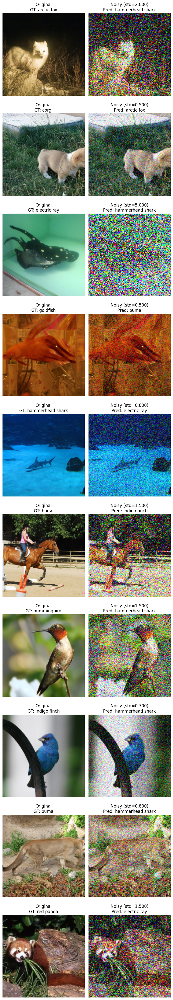

In [10]:
model = get_model(num_classes=10, weights_path=MODEL_WEIGHTS_PATH)
second_set_data = load_subset_of_images(DATA_ROOT, CLASS_NAMES, pick_index=1)
second_tensors = [x[0] for x in second_set_data]
second_labels = [x[1] for x in second_set_data]
second_paths  = [x[2] for x in second_set_data]
print(f"Number of images in second set: {len(second_tensors)}")
noise_levels = [0.0, 0.01, 0.02, 0.03, 0.05, 0.1, 0.2, 0.3, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 1.5, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0]
least_noise_to_fool = [None]*len(second_tensors)  

for i, img_t in enumerate(second_tensors):
    gt = second_labels[i]
    for nl in noise_levels:
        noised = add_gaussian_noise(img_t, std=nl)
        pred = predict(model, [noised])[0]
        if pred != gt:
            least_noise_to_fool[i] = nl
            break

noised_images_for_plot = []
std_values_for_plot = []
preds_for_plot = []

for i, img_t in enumerate(second_tensors):
    gt = second_labels[i]
    if least_noise_to_fool[i] is None:
        chosen_std = noise_levels[-1]
    else:
        chosen_std = least_noise_to_fool[i]
    noised_img = add_gaussian_noise(img_t, std=chosen_std)
    pred = predict(model, [noised_img])[0]
    noised_images_for_plot.append(noised_img)
    std_values_for_plot.append(chosen_std)
    preds_for_plot.append(pred)

print("Visualizing the original vs. noised images at the smallest std that fooled the net (or max tested).")
visualize_images(original_tensors=second_tensors, noisy_tensors=noised_images_for_plot, preds=preds_for_plot, std_values=std_values_for_plot, gts=second_labels)

# Robustness Analysis of Model Against Gaussian Noise

A lot of them visually look similar, but not very similar. 

## Experiment Overview
- Loaded a pretrained model with `num_classes=10`.
- Selected a subset of images from `DATA_ROOT` based on `CLASS_NAMES`.
- Applied Gaussian noise to each image at varying standard deviations (`std` values).
- Determined the minimum noise level (`std`) required to fool the model.

## Procedure
1. **Data Selection:** Picked a second subset of images and stored tensors, labels, and paths.
2. **Noise Injection:** Applied Gaussian noise with different `std` levels from `0.0` to `10.0`.
3. **Prediction & Fooling Criterion:** 
   - For each image, iteratively increased noise.
   - Recorded the minimum noise `std` at which the model misclassified.
4. **Visualization:** 
   - Generated side-by-side comparisons of original and noisy images.
   - Displayed the misclassification predictions at the lowest `std` that fooled the model.

## Observations
- Some images required minimal noise (`std ≈ 0.5`) to cause misclassification.
- Others were more robust, needing `std > 5.0` to fool the model.
- Different categories showed varying degrees of sensitivity to noise.


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.16369696..0.19661179].



--- Adversarial Attack for image 0 ---
Ground truth: arctic fox / Top-1 net guess was: arctic fox
Attacking next-highest-prob class: red panda, final pred: red panda


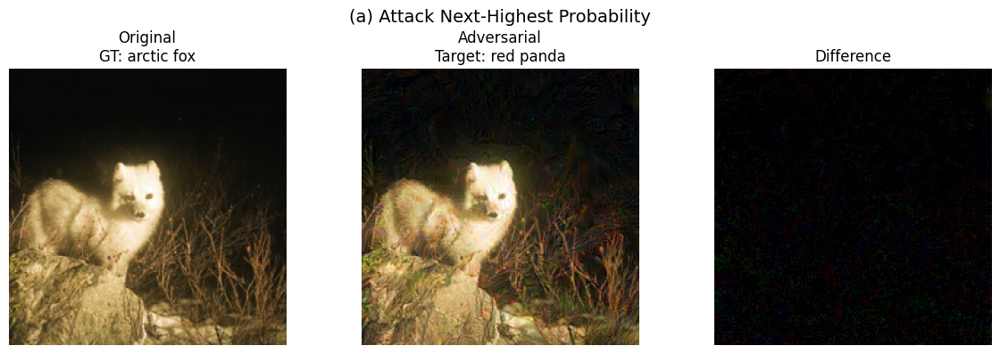

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.18178537..0.17419443].


Attacking lowest-prob class: corgi, final pred: corgi


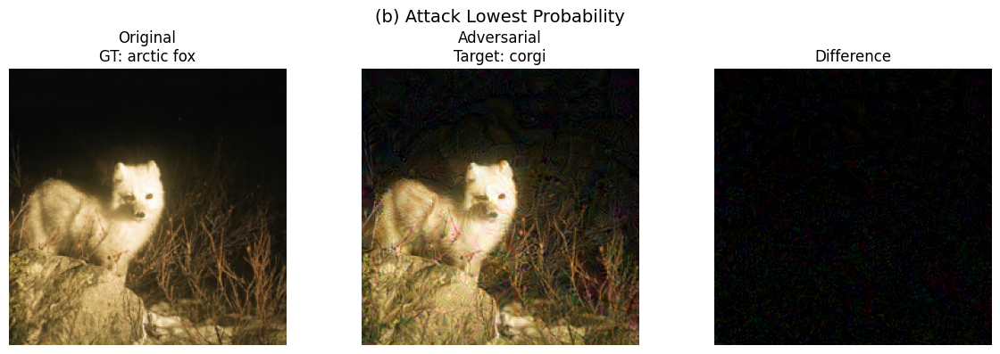

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.18499252..0.17958191].



--- Adversarial Attack for image 1 ---
Ground truth: corgi / Top-1 net guess was: corgi
Attacking next-highest-prob class: arctic fox, final pred: arctic fox


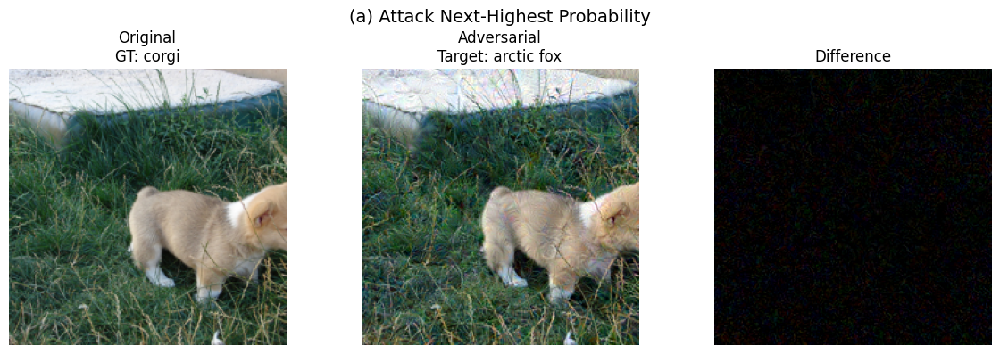

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.21983412..0.25490257].


Attacking lowest-prob class: goldfish, final pred: goldfish


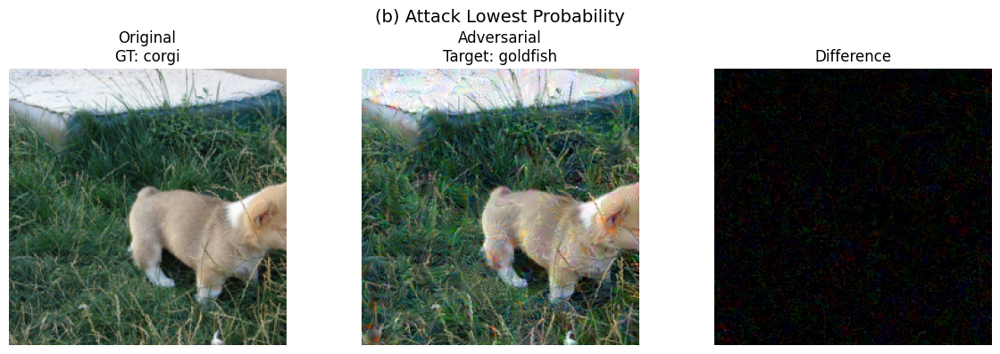

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.17698833..0.1649118].



--- Adversarial Attack for image 2 ---
Ground truth: electric ray / Top-1 net guess was: electric ray
Attacking next-highest-prob class: hammerhead shark, final pred: hammerhead shark


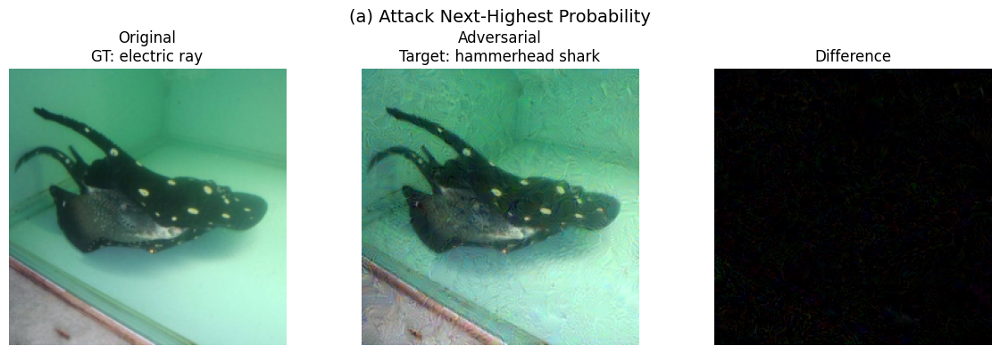

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.17104225..0.15042865].


Attacking lowest-prob class: puma, final pred: puma


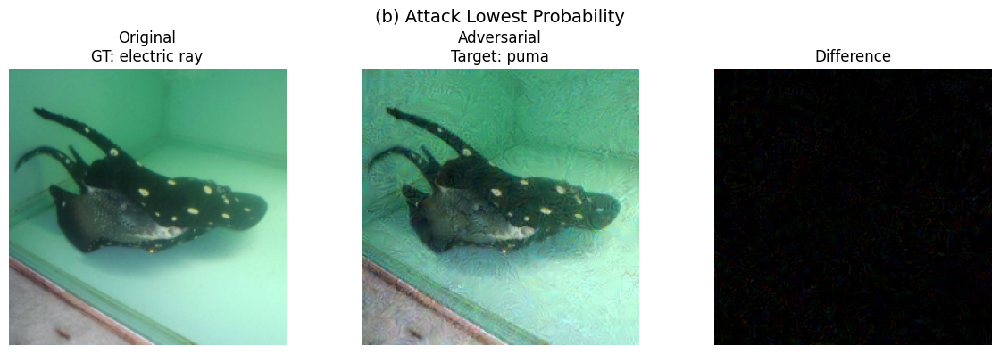

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.1835661..0.16825944].



--- Adversarial Attack for image 3 ---
Ground truth: goldfish / Top-1 net guess was: goldfish
Attacking next-highest-prob class: hummingbird, final pred: hummingbird


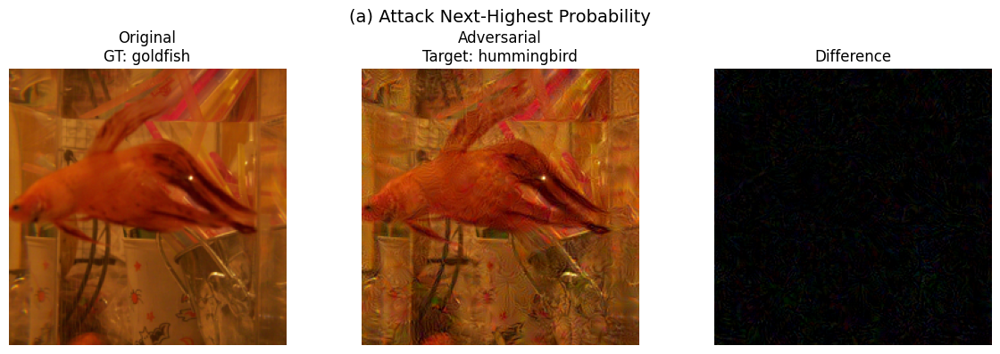

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.1676333..0.17288986].


Attacking lowest-prob class: red panda, final pred: red panda


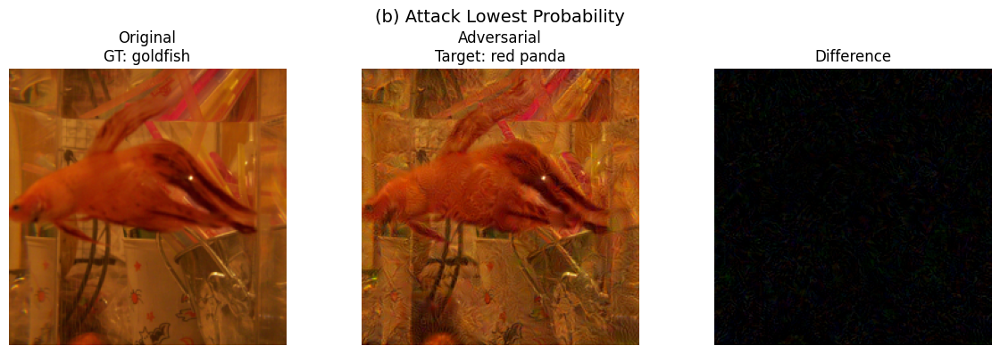

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.16905507..0.17558753].



--- Adversarial Attack for image 4 ---
Ground truth: hammerhead shark / Top-1 net guess was: hammerhead shark
Attacking next-highest-prob class: electric ray, final pred: electric ray


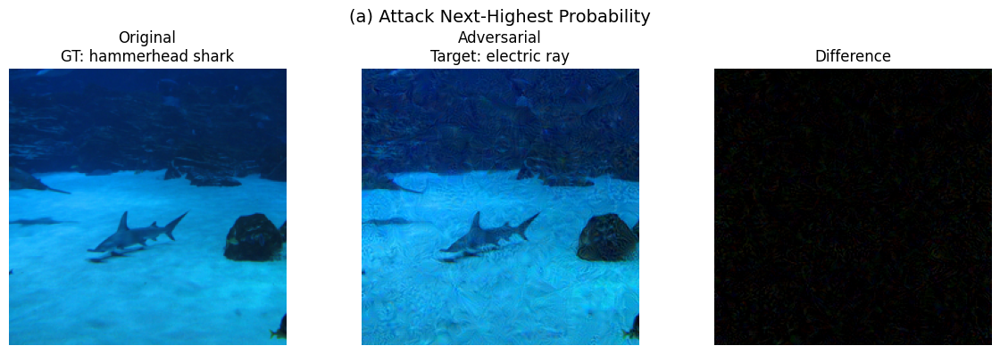

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.16753279..0.1951443].


Attacking lowest-prob class: hummingbird, final pred: hummingbird


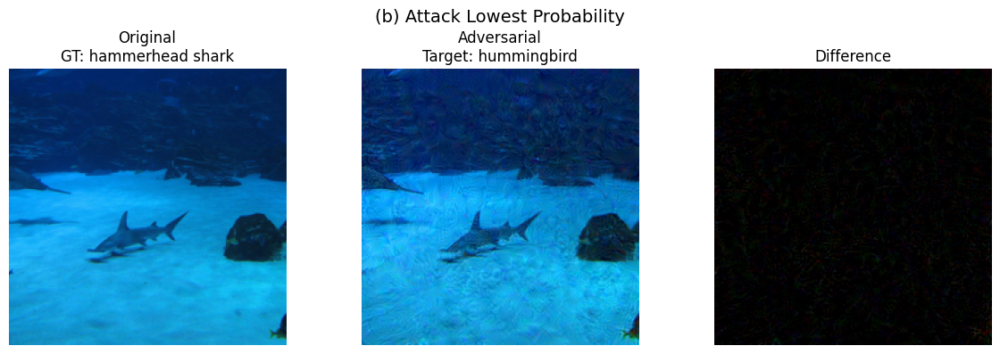

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.20232546..0.19883189].



--- Adversarial Attack for image 5 ---
Ground truth: horse / Top-1 net guess was: horse
Attacking next-highest-prob class: corgi, final pred: corgi


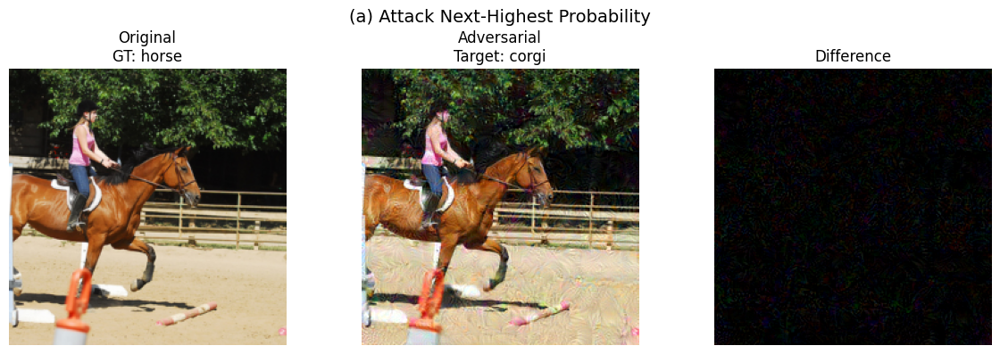

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.20051068..0.20443368].


Attacking lowest-prob class: arctic fox, final pred: arctic fox


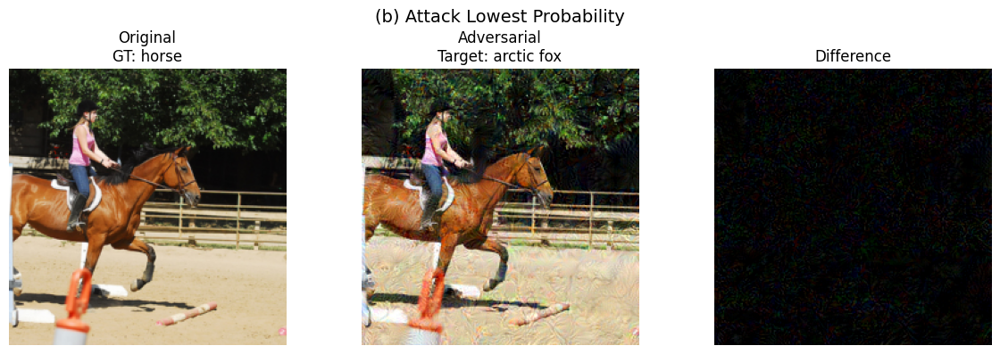

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.20834613..0.17355937].



--- Adversarial Attack for image 6 ---
Ground truth: hummingbird / Top-1 net guess was: hummingbird
Attacking next-highest-prob class: indigo finch, final pred: indigo finch


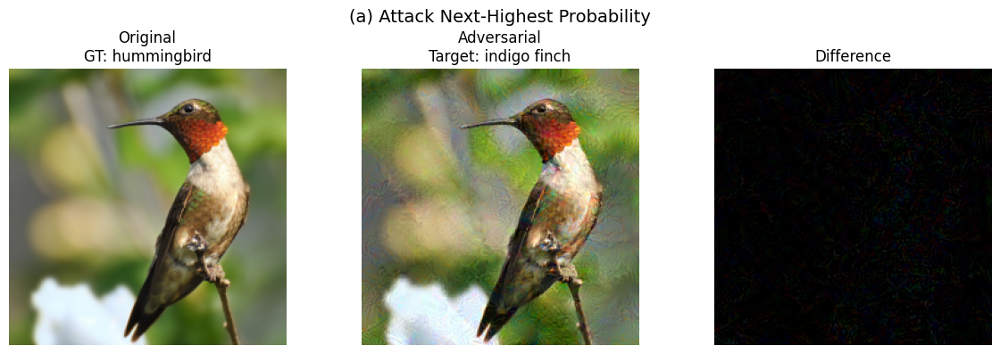

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.22260574..0.19169742].


Attacking lowest-prob class: arctic fox, final pred: arctic fox


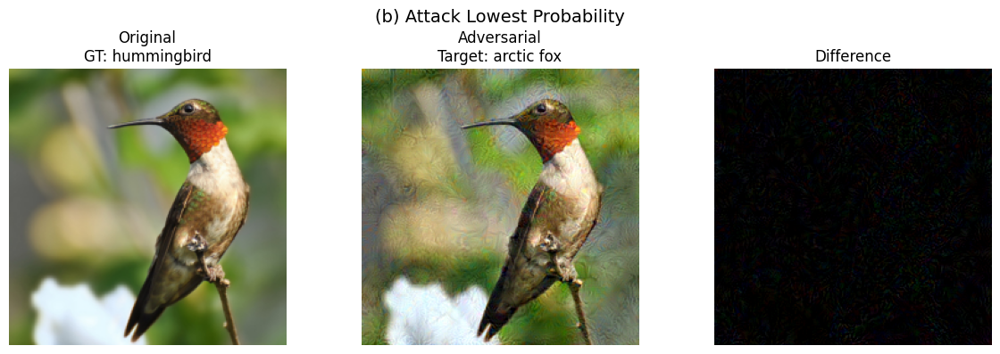


--- Adversarial Attack for image 7 ---
Ground truth: indigo finch / Top-1 net guess was: indigo finch
Attacking next-highest-prob class: hummingbird, final pred: hummingbird


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.15073028..0.16731626].


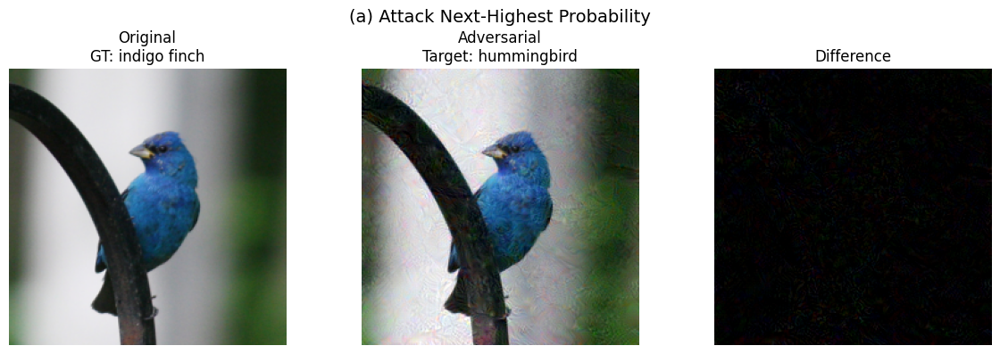

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.17095017..0.17380458].


Attacking lowest-prob class: corgi, final pred: corgi


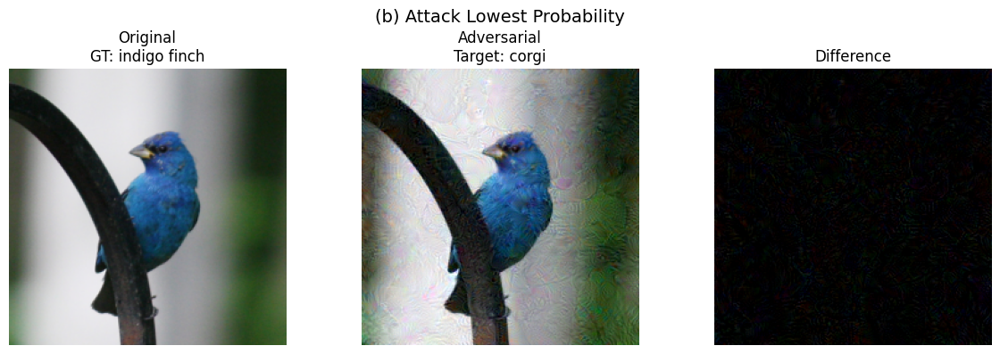

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.18994883..0.20234627].



--- Adversarial Attack for image 8 ---
Ground truth: puma / Top-1 net guess was: puma
Attacking next-highest-prob class: horse, final pred: horse


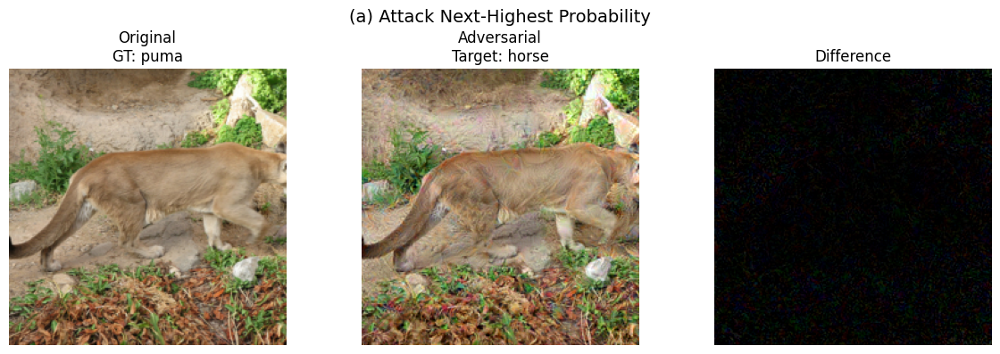

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.21986046..0.22375464].


Attacking lowest-prob class: goldfish, final pred: goldfish


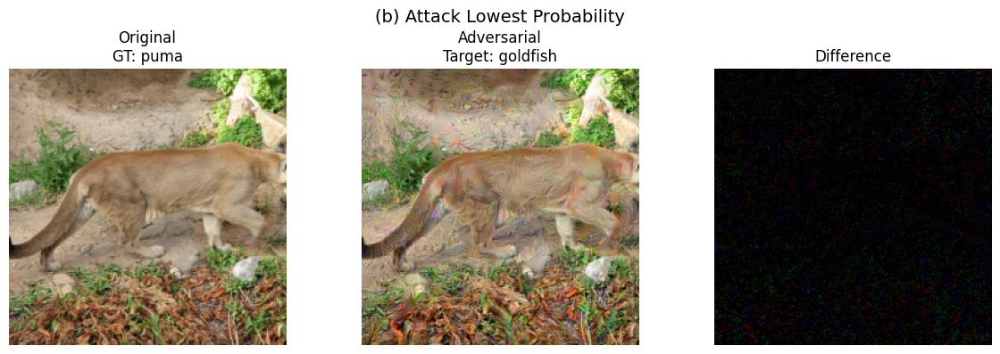

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.19505872..0.19552884].



--- Adversarial Attack for image 9 ---
Ground truth: red panda / Top-1 net guess was: red panda
Attacking next-highest-prob class: arctic fox, final pred: arctic fox


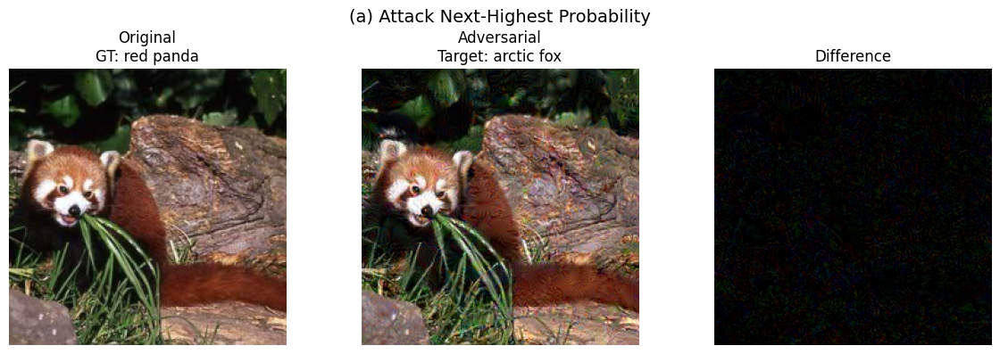

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.21761587..0.22160655].


Attacking lowest-prob class: goldfish, final pred: goldfish


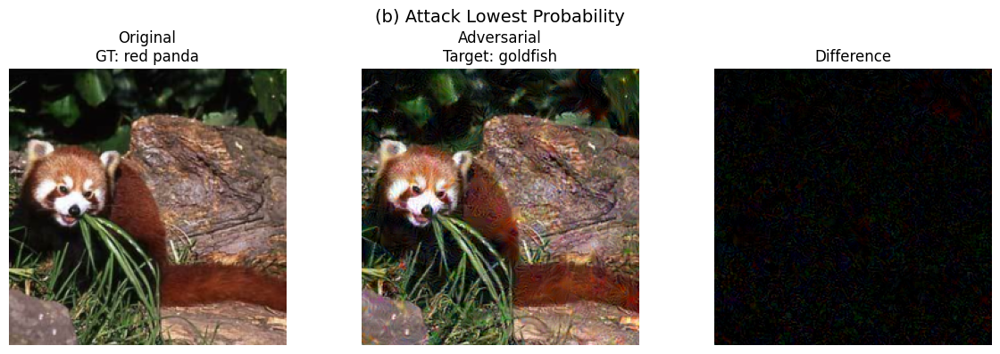

In [47]:
num_steps = 100  
lr = 0.01        
for i, (img_t, gt, path) in enumerate(second_set_data):
    model.eval()
    with torch.no_grad():
        logits = model(img_t.to(DEVICE))
    idx_top1, idx_top2, idx_bottom = get_top2_bottom1_classes(logits)
    adv_img_top2 = adversarial_optimize_image(model, img_t, target_class=idx_top2, lr=lr, steps=num_steps)
    pred_a = predict(model, [adv_img_top2])[0]
    adv_img_bottom = adversarial_optimize_image(model, img_t, target_class=idx_bottom, lr=lr, steps=num_steps)
    pred_b = predict(model, [adv_img_bottom])[0]
    print(f"\n--- Adversarial Attack for image {i} ---")
    print(f"Ground truth: {CLASS_NAMES[gt]} / Top-1 net guess was: {CLASS_NAMES[idx_top1]}")
    print(f"Attacking next-highest-prob class: {CLASS_NAMES[idx_top2]}, final pred: {CLASS_NAMES[pred_a]}")
    visualize_adversarial(original_img_t=img_t, adv_img_t=adv_img_top2, gt_label=gt, target_label=idx_top2, title="(a) Attack Next-Highest Probability" )
    print(f"Attacking lowest-prob class: {CLASS_NAMES[idx_bottom]}, final pred: {CLASS_NAMES[pred_b]}")
    visualize_adversarial( original_img_t=img_t, adv_img_t=adv_img_bottom, gt_label=gt, target_label=idx_bottom, title="(b) Attack Lowest Probability" )

### **Adversarial Attack Experiment Summary**

#### **Objective**
The experiment explores adversarial attacks on a classification model by modifying images to maximize the model’s logits for:
1. **Next-highest probability class** (most likely incorrect prediction)
2. **Lowest probability class** (least likely incorrect prediction)

The goal is to examine how much the image needs to be perturbed to change the model’s prediction.

---

#### **Methodology**
1. **Data Selection & Initial Classification**
   - A subset of images is loaded.
   - The model predicts the top-1 class (`idx_top1`), the second-highest probability class (`idx_top2`), and the lowest probability class (`idx_bottom`).

2. **Generating Adversarial Images**
   - **Attack Next-Highest Probability Class**:
     - Optimize the image to increase the logit of `idx_top2`, making it the new top-1 prediction.
   - **Attack Lowest Probability Class**:
     - Optimize the image to increase the logit of `idx_bottom`, forcing the model to predict the least likely class.

3. **Optimization Process**
   - Use gradient descent (Adam optimizer) to iteratively modify the image.
   - The loss function is set to maximize the probability of the target class.
   - The adversarial images are constrained using `torch.clamp` to keep them in a valid pixel range.

4. **Visualization**
   - The original, adversarial, and difference images are displayed side by side.
   - The final predicted class is reported.

---

### **Comparison of the Two Attack Types**
1. **Attack on Next-Highest Probability Class**
   - Requires **smaller perturbations** since the target class is already somewhat likely.
   - The adversarial image remains **visually similar** to the original.
   - The difference image (original vs adversarial) shows only minor noise patterns.

2. **Attack on Lowest Probability Class**
   - Requires **larger perturbations** as the target class is initially highly unlikely.
   - The adversarial image may become **more distorted** compared to the original.
   - The difference image reveals **more pronounced changes**, often making the attack visually noticeable.

---

### **Key Observations**
- Attacking the **next-highest probability class** is easier and results in subtle modifications.
- Attacking the **lowest probability class** requires aggressive modifications, leading to significant changes in image "surface".
- The perturbations in the second case could be larger and **potentially detectable**, whereas the first case is more stealthy.

---

### **Conclusion**
- The model is more susceptible to adversarial attacks when targeting **classes it already finds plausible**.
- Forcing the model to classify an image into an unlikely category **requires substantial distortions**.
- Future work could explore **defensive mechanisms** like adversarial training to improve robustness against these attacks.
